## Tópicos especiais de Software - Análise Enem

---



In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
df = pd.read_csv('/content/drive/MyDrive/enem_2019_tratado.csv',
                    sep=',', encoding='iso-8859-1')
df_enem = df

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 581171 entries, 0 to 581170
Data columns (total 28 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   INSCRICAO             581171 non-null  object 
 1   MUNICIPIO_RESIDENCIA  581171 non-null  object 
 2   IDADE                 581171 non-null  int64  
 3   SEXO                  581171 non-null  object 
 4   ESTADO_CIVIL          581171 non-null  object 
 5   COR_RACA              581171 non-null  object 
 6   NACIONALIDADE         581171 non-null  object 
 7   CONCLUSAO             581171 non-null  object 
 8   ESCOLA                581171 non-null  object 
 9   TREINEIRO             581171 non-null  object 
 10  COD_ESCOLA            176894 non-null  float64
 11  PRESENCA_CN           581171 non-null  object 
 12  PRESENCA_CH           581171 non-null  object 
 13  PRESENCA_LC           581171 non-null  object 
 14  PRESENCA_MT           581171 non-null  object 
 15  

In [ ]:
print(df_enem.columns)

Index(['INSCRICAO', 'MUNICIPIO_RESIDENCIA', 'IDADE', 'SEXO', 'ESTADO_CIVIL',
       'COR_RACA', 'NACIONALIDADE', 'CONCLUSAO', 'ESCOLA', 'TREINEIRO',
       'COD_ESCOLA', 'PRESENCA_CN', 'PRESENCA_CH', 'PRESENCA_LC',
       'PRESENCA_MT', 'NOTA_CN', 'NOTA_CH', 'NOTA_LC', 'NOTA_MT', 'LINGUA',
       'STATUS_REDACAO', 'NOTA_COMP1', 'NOTA_COMP2', 'NOTA_COMP3',
       'NOTA_COMP4', 'NOTA_COMP5', 'NOTA_REDACAO', 'Q025'],
      dtype='object')


In [ ]:
bins = np.histogram_bin_edges(df_enem['NOTA_CN'], bins='sturges')
print(bins)

[  0.          40.9952381   81.99047619 122.98571429 163.98095238
 204.97619048 245.97142857 286.96666667 327.96190476 368.95714286
 409.95238095 450.94761905 491.94285714 532.93809524 573.93333333
 614.92857143 655.92380952 696.91904762 737.91428571 778.90952381
 819.9047619  860.9       ]


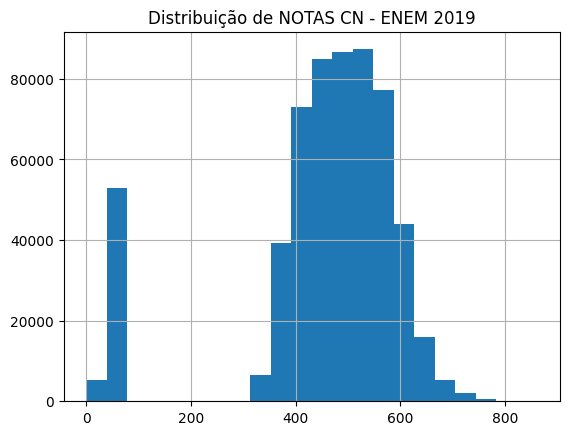

In [ ]:
df_enem.NOTA_CN.hist(bins=len(bins))
plt.title('Distribuição de NOTAS CN - ENEM 2019')
plt.show()

<Axes: xlabel='NOTA_CN', ylabel='Count'>

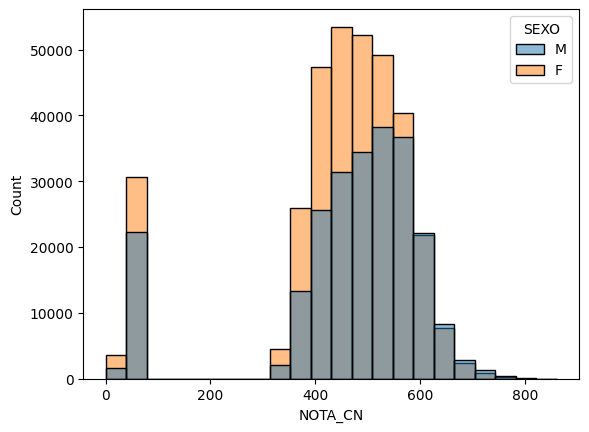

In [ ]:
sns.histplot(df_enem, x="NOTA_CN", hue="SEXO", bins=len(bins))

In [ ]:
grafico =  px.histogram (df_enem,  x = "NOTA_CN", nbins=25, color='SEXO')
grafico.update_layout(width=500,height=500,title_text='Distribuição NOTAS por SEXO',
                      title_font_color = 'black')
grafico.show()

In [ ]:
fig = px.box(df_enem, x="SEXO", y="NOTA_CN")
fig.show()

In [ ]:
fig = px.box(df_enem, x="COR_RACA", y="NOTA_CN")
fig.show()

In [ ]:
percentual = 10
coluna_filtragem = 'NOTA_CN'


df_ordenado = df.sort_values(by=coluna_filtragem)
limite = df_ordenado[coluna_filtragem].quantile(percentual / 100)

df_filtrado = df_ordenado[df_ordenado[coluna_filtragem] <= limite]

fig = px.scatter(df_filtrado, x='NOTA_CN', y='MUNICIPIO_RESIDENCIA', color="IDADE",
                 size='NOTA_CN', hover_data=['MUNICIPIO_RESIDENCIA'])
fig.show()

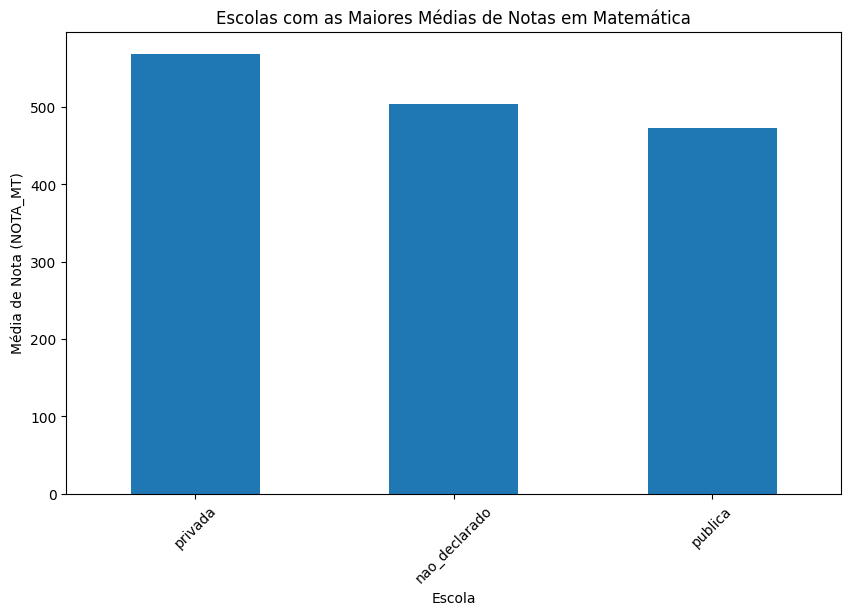

In [47]:
import pandas as pd
import matplotlib.pyplot as plt
media_notas_por_escola = df_filtrado.groupby('ESCOLA')[['NOTA_CN', 'NOTA_CH', 'NOTA_LC', 'NOTA_MT', 'NOTA_REDACAO']].mean()
top_escolas = media_notas_por_escola.nlargest(10, 'NOTA_MT')
fig, ax = plt.subplots(figsize=(10, 6))
top_escolas['NOTA_MT'].plot(kind='bar', ax=ax)
plt.title('Escolas com as Maiores Médias de Notas em Matemática')
plt.xlabel('Escola')
plt.ylabel('Média de Nota (NOTA_MT)')
plt.xticks(rotation=45)
plt.show()
